# Topic: Team detection based on image embeddings

In [1]:
import os
import plotly.express as px
import numpy as np
import pandas as pd

from ultralytics import YOLO
from PIL import Image


#### Step 1: load image data & trained model

In [2]:
#load images
frame_files = os.listdir('../data/processed/ultimate_detect/images/train/')
frames = [ Image.open('../data/processed/ultimate_detect/images/train/' + frame_file) 
        for frame_file in frame_files]

#load YOLOv8 model

model = YOLO('../model/best.pt')

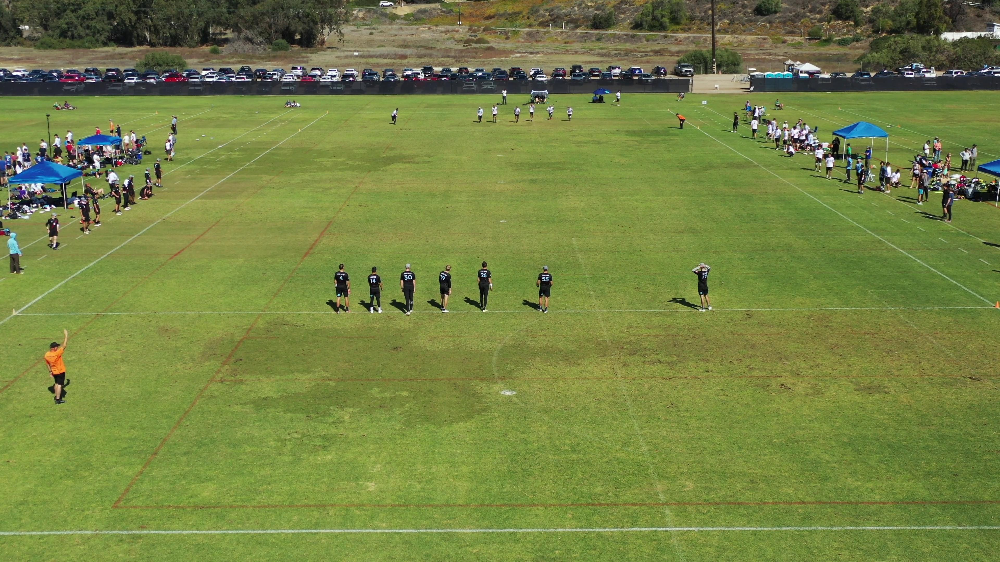

In [3]:
frame = frames[1]
frame

#### Step 2: Extract players using object detection model

In [4]:

#detect players and extract subimages
results = model.predict(frame, conf=0.2)

player_imgs = []
for result in results:
    for cls, box in zip(result.boxes.cls.tolist(), result.boxes.xyxy.tolist()):
        if cls == 0:
            #crop player boxes
            cropped_img = frame.crop(box).resize((128, 256))
            player_imgs.append(cropped_img)       


0: 2176x3840 14 Players, 2 Referees, 4991.2ms
Speed: 152.9ms preprocess, 4991.2ms inference, 13.7ms postprocess per image at shape (1, 3, 2176, 3840)


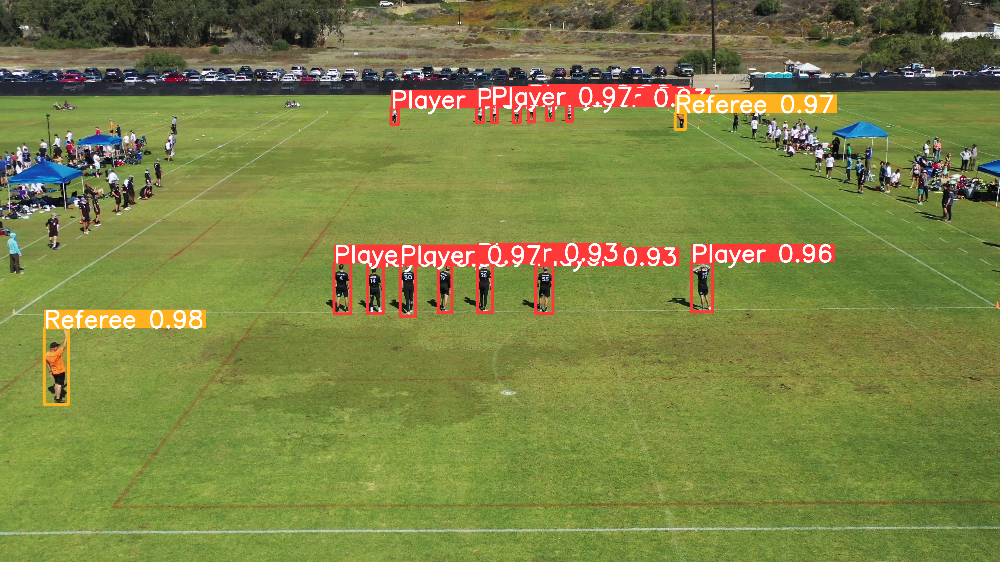

In [5]:
Image.fromarray(results[0].plot()[..., ::-1])

In [6]:
#show extracted players

import plotly.subplots as sp
import plotly.express as px

def plot_list_of_players(img_list:list[Image.Image],pred_labels:list[str] = None):
    fig = sp.make_subplots(rows=1, cols=len(img_list))

    for i, img in enumerate(img_list, start=1):
        fig.add_trace(
            px.imshow(img).data[0],
            row=1, col=i
        )
        
        if pred_labels is not None:
            fig.update_xaxes(title_text=str(pred_labels[i-1]), row=1, col=i)
    
    fig.show()

In [7]:
plot_list_of_players(player_imgs,None)

## Flatten image + Kmeans clustering

In [9]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans


data = np.array([np.array(img).flatten() for img in player_imgs])

#Kmeans clustering
kmeans = KMeans(n_clusters=2)
pred_labels = kmeans.fit_predict(data)
distances = kmeans.transform(data)
assigned_cluster_distances = np.min(distances, axis=1)

# Run PCA
pca = PCA(n_components=3)
data_pca = pca.fit_transform(data)

# Convert the PCA-reduced embeddings to a DataFrame
df = pd.DataFrame(data_pca, columns=['Component 1', 'Component 2', 'Component 3'])

cluster_centers = kmeans.cluster_centers_
print(distances)
#center_images = cluster_centers.reshape(-1, *player_imgs[0].shape)
# Plot the PCA-reduced embeddings
#fig = px.scatter_3d(df, x='Component 1', y='Component 2', z='Component 3', color=pred_labels)
#fig.show()

[[      14257       24928]
 [      27105       10684]
 [      11253       24583]
 [      13818       22393]
 [      23188       11507]
 [      12189       23726]
 [      12987       25005]
 [      11836       23815]
 [      12263       25405]
 [      23559       10919]
 [      23740       12050]
 [      27197       13483]
 [      22096       11976]
 [      20713       14572]]


## plot players and predicted labels

In [10]:
plot_list_of_players(player_imgs,pred_labels)